<picture>
  <!--Imagem para o tema dark-->
  <source media="(prefers-color-scheme: dark)" srcset="https://github.com/CatarinaAguiar3/Projeto_Sistema_de_Recomendacao_MovieLens/blob/main/Imagens/Banners/Dark_Titulo3_Analise_Descritiva.png?raw=true">
  
  <!--Imagem para o tema light-->
  <source media="(prefers-color-scheme: light)" srcset="https://github.com/CatarinaAguiar3/Projeto_Sistema_de_Recomendacao_MovieLens/blob/main/Imagens/Banners/Titulo3_Analise_Descritiva_v2.png?raw=true">

  <!--Imagem padrão (quando os temas dark e light não forem identificados -->
  <img src="https://github.com/CatarinaAguiar3/Projeto_Sistema_de_Recomendacao_MovieLens/blob/main/Imagens/Banners/Titulo3_Analise_Descritiva_v2.png?raw=true">
</picture>

# **Importar Bibliotecas**

In [1]:
import pandas as pd
import os
import numpy as np

In [2]:
# Worcloud
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [3]:
# Gráficos
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

# Salvar o gráfico como um arquivo HTML
import plotly.io as pio


In [4]:
# Calcular a correlação
from scipy.stats import pearsonr
from scipy.stats import spearmanr

In [5]:
import numpy as np
import statsmodels.api as sm

In [6]:
# tabset
import jinja2
get_ipython().run_line_magic('load_ext', 'pretty_jupyter')

# **Definir Diretório**

In [10]:
os.chdir("C:/0.Projetos/5.Sistema_de_Recomendacao_MovieLens_2")

# **Carregar Arquivos**

In [7]:
genome_treino= pd.read_pickle("C:/0.Projetos/5.Sistema_de_Recomendacao_MovieLens_2/Datasets/3.Datasets_Transformação/3.2_Datasets_Transformação_parte_2/genome_treino.pickle", compression='gzip')

In [33]:
genome_treino.head(3)

,movieId,tagId,relevance,tag
0,1,1,0.03200,007
1,1,2,0.02225,007 (series)
2,1,3,0.07000,18th century


In [8]:
tags_treino = pd.read_pickle("C:/0.Projetos/5.Sistema_de_Recomendacao_MovieLens_2/Datasets/2.Datasets_Limpeza/tags_treino.pickle", compression = "gzip")

In [35]:
tags_treino

,userId,movieId,tag,timestamp
0,134,89898,advertising,1521614243
1,134,89898,drugs,1521614238
2,134,89898,Russia,1521614240
3,134,182899,Action,1514209025
4,134,182899,Asia,1514209050
...,...,...,...,...
44612,330008,79091,nerds,1433358037
44613,330008,79091,supervillain,1433358009
44614,330008,81564,animation,1433357978
44615,330008,81564,funny,1433357989


In [29]:
ratings_treino_transformado = pd.read_pickle("C:/0.Projetos/5.Sistema_de_Recomendacao_MovieLens_2/Datasets/3.Datasets_Transformação/3.1_Datasets_Transformação_parte_1/ratings_treino_transformado.pickle", compression = "gzip")

In [30]:
ratings_treino_transformado.head(3)

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado
0,5,43,47,1567,5.0,4.057754,3.286254
1,461,1692,47,1567,4.5,4.057754,3.286254
2,751,469,47,1567,3.0,4.057754,3.286254


In [31]:
movies_treino_transformado = pd.read_pickle("C:/0.Projetos/5.Sistema_de_Recomendacao_MovieLens_2/Datasets/3.Datasets_Transformação/3.2_Datasets_Transformação_parte_2/movies_treino_transformado.pickle", compression = 'gzip')

In [32]:
movies_treino_transformado.head(3) 

,movieId,title,genres,Ano_do_filme,titulo_sem_ano,genres_separado
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,Toy Story,Adventure
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995,Jumanji,Adventure
2,3,Grumpier Old Men (1995),Comedy|Romance,1995,Grumpier Old Men,Comedy


# **Funções**

## Função 1: Calcula o Resumo Estatístico

In [11]:
def resumo_estatistico(tabela:pd.DataFrame, coluna:str) -> pd.DataFrame:

    # Calcula estatísticas descritivas usando agg
    resumo = tabela[coluna].agg(['count', 'mean','median', 'std', 'min', 'max' ]).round(2)

    # Renomeiar a coluna 'median' para 'median (50%)'
    resumo = resumo.rename(index={'median': 'median (50%)'})

    # Calcula percentis usando quantile
    percentis = tabela[coluna].quantile([0.25, 0.5, 0.75]).round(2)

    # Combina os resultados em um DataFrame único
    resumo = pd.concat([resumo, percentis.rename({0.25: '25%', 0.5: '50%', 0.75: '75%'})])

    display(resumo)

## Função 2: Retorna a frequência e proporção dos valores únicos

In [12]:
def valores_unicos(tabela:pd.DataFrame, coluna:str) -> pd.DataFrame:
    
    # Calcula a contagem dos valores únicos usando value_counts
    contagem = tabela[coluna].value_counts().reset_index()

    # Renomeia as colunas para tornar o resultado mais claro
    contagem.columns = ['Valor_Único', 'Frequência']

    # Adiciona uma coluna de proporção em porcentagem
    contagem['Proporção (%)'] = (contagem['Frequência'] / contagem['Frequência'].sum()) * 100

    # Arredonda a coluna de proporção para 4 casas decimais
    contagem['Proporção (%)'] = contagem['Proporção (%)'].round(4)

    # Formata a coluna de proporção como porcentagem
    contagem['Proporção (%)'] = contagem['Proporção (%)'].map('{:.4f}%'.format)


    return contagem

# **1. Quantidade de usuários, de filmes e de gêneros**
Nesta amostra, existem 7.943 clientes, 24.345 filmes e 19 gêneros de filmes.  

In [13]:
quantidade_user = ratings_treino_transformado['userId'].nunique()
quantidade_filmes = ratings_treino_transformado['movieId'].nunique()
quantidade_generos = movies_treino_transformado['genres_separado'].nunique()

In [43]:
print(f"Quantidade de usuários: {quantidade_user} ")
print(f"Quantidade de filmes: {quantidade_filmes} ")
print(f"Quantidade de genero: {quantidade_generos} ")

Quantidade de usuários: 7943 
Quantidade de filmes: 24345 
Quantidade de genero: 19 


## Gráfico: usuários, filmes e gêneros

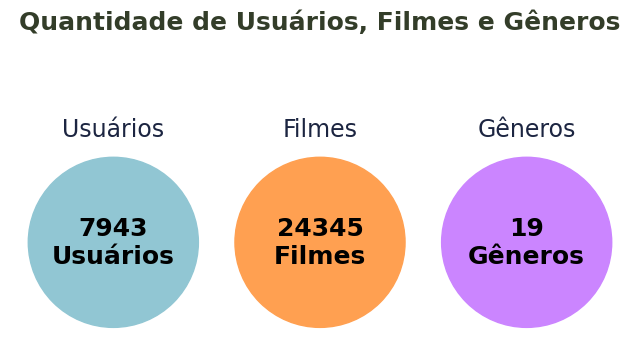

In [21]:
# Criação do gráfico
plt.figure(figsize=(8, 4))

# Definição das posições dos pontos
x_positions = [0.5, 1.5, 2.5]
y_positions = [1, 1, 1]

# Definição das cores dos pontos
#colors = ['#06837f', 'orange'ou '#ffc675', '#6a0572']
#colors = ['#96c9c2','#ffc675' , '#b978b0']
colors = ['#91C6D3','#FFA051' , '#CB85FF']
# Definição dos tamanhos dos pontos
sizes = [15000, 15000, 15000]

# Criação dos pontos no gráfico
plt.scatter(x=x_positions, y=y_positions, s=sizes, color=colors)

# Definição dos limites dos eixos
plt.xlim(0, 3)
plt.ylim(0.9, 1.2)

# Adição de títulos e rótulos
plt.title('Quantidade de Usuários, Filmes e Gêneros', fontsize=18, weight=600, color='#333d29')
plt.text(0.5, 1, f'{quantidade_user}\nUsuários', va='center', ha='center', fontsize=18, weight=600, color='black')
plt.text(1.5, 1, f'{quantidade_filmes}\nFilmes', va='center', ha='center', fontsize=18, weight=600, color='black')
plt.text(2.5, 1, f'{quantidade_generos}\nGêneros', va='center', ha='center', fontsize=18, weight=600, color='black')
plt.text(0.5, 1.11, 'Usuários', va='center', ha='center', fontsize=17, weight=500, color='#1c2541')
plt.text(1.5, 1.11, 'Filmes', va='center', ha='center', fontsize=17, weight=500, color='#1c2541')
plt.text(2.5, 1.11, 'Gêneros', va='center', ha='center', fontsize=17, weight=500, color='#1c2541')

# Desliga a exibição dos eixos
plt.axis('off')

# Exibição do gráfico
plt.show()

# **2. Distribuição estatística de Ratings**
A média de ratings é 3,52 e as notas mais dadas são 4, 3, 5 e 3.5 respectivamente. Estes valores mostram que os filmes tem uma avaliação intermediária.

### Resumo Estatístico de Ratings

In [45]:
resumo_estatistico(ratings_treino_transformado, 'rating')

count           820508.00
mean                 3.52
median (50%)         3.50
std                  1.07
min                  0.50
max                  5.00
25%                  3.00
50%                  3.50
75%                  4.00
Name: rating, dtype: float64

### Proporção dos Valores únicos de Ratings

In [46]:
valores_unicos(ratings_treino_transformado, 'rating')

,Valor_Único,Frequência,Proporção (%)
0,4.0,213944,26.0746%
1,3.0,156350,19.0553%
2,5.0,114835,13.9956%
3,3.5,107438,13.0941%
4,4.5,75437,9.1939%
5,2.0,54051,6.5875%
6,2.5,43567,5.3098%
7,1.0,24483,2.9839%
8,0.5,15507,1.8899%
9,1.5,14896,1.8155%


### Gráfico BoxPlot - Distribuição Rating

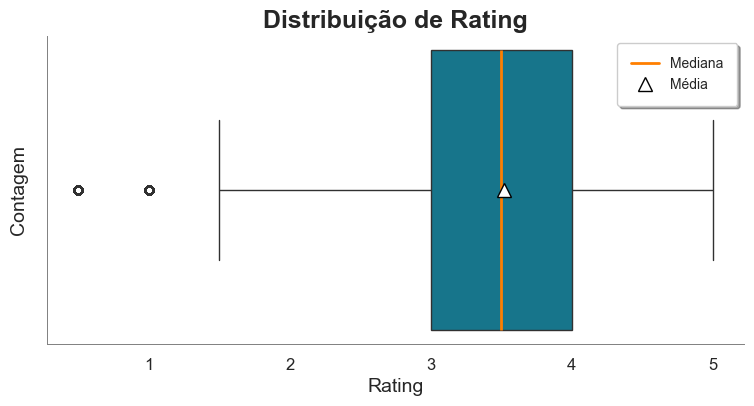

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt

# Ajustar o estilo e a paleta de cores
sns.set(style="white", palette="muted")

# Ajustar a escala para melhor visualização
plt.figure(figsize=(9, 4))

# Criar o boxplot
ax = sns.boxplot(x=ratings_treino_transformado['rating'], 
                 color="#04819E",
                 medianprops={"color": "#FF7F00", "linewidth": 2},
                 showmeans=True,
                 meanprops={"markerfacecolor":"white", 
                            "markeredgecolor":"black",
                            "markersize":"10"})

# Adicionar legendas manuais
plt.plot([], [], color='#FF7F00', label='Mediana', linewidth=2)
plt.plot([], [], 'w^', label='Média', markersize=10, markeredgecolor="black")

# Adicionar título e rótulos aos eixos
plt.title('Distribuição de Rating', fontsize=18, fontweight='bold')
plt.xlabel('Rating', fontsize=14)
plt.ylabel('Contagem', fontsize=14)

# Exibir a legenda à esquerda
plt.legend(loc='upper right', fontsize=10, frameon=True, fancybox=True, shadow=True, borderpad=1)

# Ajustar a cor das bordas esquerda e direita
ax.spines['bottom'].set_color('#808080')  # definir a cor desejada para a borda esquerda
ax.spines['left'].set_color('#808080')  # definir a cor desejada para a borda direita
ax.spines['bottom'].set_linewidth(0.7)  # ajustar a largura da borda esquerda
ax.spines['left'].set_linewidth(0.7)  # ajustar a largura da borda direita

# Remover as bordas de cima e da direita
sns.despine(top=True, right=True)

# Ajustar os ticks dos eixos
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Exibir o gráfico
plt.show()


### Gráfico- Contagem de valores de Rating

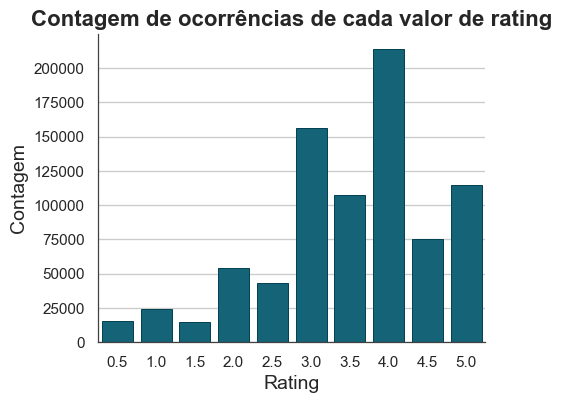

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns

# Criar um gráfico de contagem para a coluna ratings
plt.figure(figsize=(5, 4))
sns.set(style="whitegrid")
ax = sns.countplot(x=ratings_treino_transformado['rating'], color="#046D86")

# Adicionar título e rótulos aos eixos
plt.title('Contagem de ocorrências de cada valor de rating', fontsize=16, fontweight='bold')
plt.xlabel('Rating', fontsize=14)
plt.ylabel('Contagem', fontsize=14)

# Ajustar a cor das bordas
ax.spines['bottom'].set_color('#404040')
ax.spines['left'].set_color('#404040')

# Ajustar a largura das bordas 
ax.spines['bottom'].set_linewidth(0.9)
ax.spines['left'].set_linewidth(0.9)

# Adicionar bordas às barras
for patch in ax.patches:
    patch.set_edgecolor('#004050')  # cor da borda
    patch.set_linewidth(0.7)        # espessura da borda

# Remover as bordas de cima e da direita
sns.despine(top=True, right=True)

# Exibir o gráfico
plt.show()


# **3.Quantidade de filmes que um usuário avalia**
Um usuário avalia em média 609 filmes e a mediana é 318. A maioria dos usuários faz 15 avaliações, seguidos de usuários que fazem 5.071 , 4.228, 4.135 e 16 avaliações, respectivamente. 
<br><br>
Pensamos em duas hipóteses sobre os usuários que fazem 15 avaliações: <br>
$H_0:$ Os usuários são novos no site, por isso, fizeram poucas avaliações. <br>
$H_1:$ Os usuários utilizaram o site por um tempo e não ficaram satisfeitos. Por isso, deixaram de usá-lo. 
<br><br>
Para entender qual é a hipótese mais provável, fizemos uma análise gráfica do número de avaliações por usuário e da média de ratings. Ao olhar o histograma, observa-se que a maioria das avaliações por usuários fica entre 0 e 1.000. <br>
Por isso, criamos um outro gráfico cujo intervalo fica entre 0 e 1.000. E notamos que a partir de 40 avaliações por usuário, a contagem começa a diminuir. 
<br><br>
Em relação a ratings, separamos o dataset em faixas e examinamos a média desta coluna. O que observamos é que , em média, ratings diminui conforme o número de avaliações aumenta. 

> $\uparrow$ Contagem do Número de Avaliações por usuário  $\ \ \ \ $ $\downarrow$  Nota dada (rating)

Isto pode ser resultado de uma insatisfação dos usuários com as recomendações $(H_1)$.


In [49]:
ratings_treino_transformado.head()

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado
0,5,43,47,1567,5.0,4.057754,3.286254
1,5,43,175,140,4.0,3.482143,1.258266
2,5,43,257,104,4.0,3.341346,1.032082
3,5,43,318,2948,4.0,4.415366,3.888469
4,5,43,319,207,4.0,3.910628,1.708250


### Resumo Estatístico do Nº de Avaliações por Usuários

In [50]:
resumo_estatistico(ratings_treino_transformado,'Numero_de_Avaliacoes_por_usuarios' )

count           820508.00
mean               609.36
median (50%)       318.00
std                821.60
min                  1.00
max               5071.00
25%                122.00
50%                318.00
75%                733.00
Name: Numero_de_Avaliacoes_por_usuarios, dtype: float64

### Rating por faixas 
Separamos a coluna rating em diferentes faixas para identificar se, em média, há alguma relação com o aumento do número de avaliações por usuário. 

In [33]:
filtro_0_40 = ratings_treino_transformado.loc[(ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 40)]
filtro_41_500 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 40) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 500)
]

filtro_501_1000 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 501) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 1000)
]

filtro_1001_1500 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 1001) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 1500)
]

filtro_1501_2000 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 1501) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 2000)
]

filtro_2001_3000 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 2001) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 3000)
]

filtro_3001_4500 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 3001) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 4500)
]

filtro_4501_5071 = ratings_treino_transformado.loc[
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= 4501) &
    (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 5071)
]

In [34]:
faixas = pd.DataFrame({
    'Faixas_Numero_de_avaliacoes':['0-40','41-500', '501-1000', '1001-1500', '1501-2000', '2001-3000', '3001-4500', '4501-5071'],
    'Faixas_Numero_de_avaliacoes2':[40,500, 1000, 1500, 2000,3000,4500, 5071],
    'Rating_por_faixa':[filtro_0_40['rating'].mean(), filtro_41_500['rating'].mean(),filtro_501_1000['rating'].mean(), filtro_1001_1500['rating'].mean(), filtro_1501_2000['rating'].mean(), filtro_2001_3000['rating'].mean(),filtro_3001_4500['rating'].mean(),filtro_4501_5071['rating'].mean()]
})
faixas

,Faixas_Numero_de_avaliacoes,Faixas_Numero_de_avaliacoes2,Rating_por_faixa
0,0-40,40,3.696145
1,41-500,500,3.650309
2,501-1000,1000,3.417410
3,1001-1500,1500,3.235099
4,1501-2000,2000,3.254429
5,2001-3000,3000,2.961035
6,3001-4500,4500,2.877094
7,4501-5071,5071,2.658154


### Gráfico Número de avaliações por usuário e rating

In [96]:
# Dados para o histograma
histogram_data = ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios']

# Dados para o grafico de linha
df_linha = faixas

# Criar o gráfico combo com histograma e linha
fig = go.Figure()

# Adicionar histograma
fig.add_trace(go.Histogram(
    x=histogram_data,
    nbinsx=100,
    marker_color="#7D01D6",
    marker_line_color='white',
    marker_line_width=1.5,
    name='Distribuição do número de avaliações de filme por usuário',
    yaxis='y1'  # Associando ao eixo y1 (à esquerda)
))

# Adicionar linha com médias de rating por faixa
fig.add_trace(go.Scatter(
    x=df_linha['Faixas_Numero_de_avaliacoes2'],
    y=df_linha['Rating_por_faixa'],
    mode='lines+markers',
    line=dict(color='#FF5733', width=2.9),
    marker=dict(color='#FF5733', size=9),
    name='Média de Ratings por Faixa de Número de Avaliações por Usuário',
    xaxis='x',
    yaxis='y2'  # Associando ao eixo y2 (à direita)
))

# Atualizar layout do gráfico
fig.update_layout(
    width=950,
    height=550,
    title='Distribuição do número de avaliações de filme por usuário e Média de Ratings por Faixa',
    title_font=dict(size=20, family='Arial', color='black', weight='bold'),  # Tamanho e estilo do título
    xaxis_title='Número de avaliações de filme por usuário',
    yaxis_title='Contagem',
     xaxis=dict(
        tickmode='linear',
        tick0=0,
        dtick=500,
        tickfont=dict(size=12),
    ),
    yaxis=dict(
        title='Contagem',
        side='left',  # Posicionar à esquerda
        showgrid=False,
        showticklabels=True,
        tickfont=dict(size=12),
    ),
    yaxis2=dict(
        title='Média de Rating',
        overlaying='y',
        side='right',  # Posicionar à direita
        showgrid=False,
        showticklabels=True,
        tickfont=dict(size=12),
    ),
    font=dict(family="Arial", size=12),
    legend=dict(
        x=0.5,  # Posição horizontal da legenda em relação ao gráfico
        y=1.05,   # Posição vertical da legenda em relação ao gráfico
        traceorder='normal',
        font=dict(
            family='Arial',
            size=12,
            color='black'
        ),
        bgcolor='rgba(255, 255, 255, 0.5)',
        bordercolor='rgba(0, 0, 0, 0.4)',
        borderwidth=1
    ),
    showlegend=True,
    plot_bgcolor='white'
)

# Exibir o gráfico
fig.show()

In [97]:
# Salvar o gráfico como um arquivo HTML
import plotly.io as pio
pio.write_html(fig, file='Distribuicao_Numero_de_avaliacoes_por_usuario.html', auto_open=True)

<!--<iframe src="Distribuicao_Numero_de_avaliacoes_por_usuario.html", width="1050", height="600" ></iframe>-->
<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.3/Distribuicao_Numero_de_avaliacoes_por_usuario.html" width="150%" height="600px" frameborder="0" scrolling="no"></iframe>

## Comparar as médias de quem avalia muito e pouco
Vamos analisar a média da coluna rating dos usuários que avaliaram até 1.000 filmes e dos usuários que avaliaram mais de 1.000 filmes.

### Selecionar apenas até 1.000 avaliações por usuário

In [88]:
filtro_1000 = ratings_treino_transformado.loc[(ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= 1000)]
filtro_1000.head(3)

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado
0,5,43,47,1567,5.0,4.057754,3.286254
2,751,469,47,1567,3.0,4.057754,3.286254
4,1174,12,47,1567,5.0,4.057754,3.286254


In [89]:
import pandas as pd

# Definindo os intervalos e rótulos das faixas
faixas_definidas = [
    (0, 40),
    (11, 80),
    (81, 100),
    (101, 150),
    (151, 200),
    (201, 250),
    (251, 300),
    (301, 350),
    (351, 400),
    (401, 550),
    (551, 650),
    (651, 700),
    (701, 800),
    (801, 1000)
]

# Criando uma lista para armazenar os resultados
faixas_data = []

# Iterando sobre os intervalos
for faixa in faixas_definidas:
    faixa_min, faixa_max = faixa
    filtro = ratings_treino_transformado.loc[
        (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] >= faixa_min) &
        (ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'] <= faixa_max)
    ]
    faixa_label = f'{faixa_min}-{faixa_max}'
    rating_medio = filtro['rating'].mean()
    # Obtendo o último número da faixa
    ultimo_numero = faixa_max
    faixas_data.append({
        'Faixas_Numero_de_avaliacoes': faixa_label,
        'Faixas_Numero_de_avaliacoes2': ultimo_numero,
        'Rating_por_faixa': rating_medio
    })

# Criando o DataFrame a partir da lista de dicionários
faixas1 = pd.DataFrame(faixas_data)

# Exibindo o DataFrame com as faixas, o último número da faixa e as médias de rating
print(faixas1)


   Faixas_Numero_de_avaliacoes  Faixas_Numero_de_avaliacoes2  Rating_por_faixa
0                         0-40                            40          3.696145
1                        11-80                            80          3.729868
2                       81-100                           100          3.747573
3                      101-150                           150          3.722232
4                      151-200                           200          3.678422
5                      201-250                           250          3.679058
6                      251-300                           300          3.576646
7                      301-350                           350          3.585126
8                      351-400                           400          3.559443
9                      401-550                           550          3.447619
10                     551-650                           650          3.466044
11                     651-700                      

In [99]:
# Dados para o histograma
histogram_data = filtro_1000['Numero_de_Avaliacoes_por_usuarios']

# Dados para o grafico de linha
df_linha1 = faixas1

# Criar o gráfico combo com histograma e linha
fig = go.Figure()

# Adicionar histograma
fig.add_trace(go.Histogram(
    x=histogram_data,
    nbinsx=50,
    marker_color="#7D01D6",
    marker_line_color='white',
    marker_line_width=1.5,
    name='Distribuição do número de avaliações de filme por usuário',
    yaxis='y1'  # Associando ao eixo y1 (à esquerda)
))

# Adicionar linha com médias de rating por faixa
fig.add_trace(go.Scatter(
    x=df_linha1['Faixas_Numero_de_avaliacoes2'],
    y=df_linha1['Rating_por_faixa'],
    mode='lines+markers',
    line=dict(color='#FF5733', width=2.9),
    marker=dict(color='#FF5733', size=9),
    name='Média de Ratings por Faixa de Número de Avaliações por Usuário',
    xaxis='x',
    yaxis='y2'  # Associando ao eixo y2 (à direita)
))

# Atualizar layout do gráfico
fig.update_layout(
    width=1050,
    height=550,
    title='Distribuição do número de avaliações de filme por usuário e Média de Ratings por Faixa (até 1.000 avaliações)',
    title_font=dict(size=19, family='Arial', color='black', weight='bold'),  # Tamanho e estilo do título
    xaxis_title='Número de avaliações de filme por usuário',
    yaxis_title='Contagem',
     xaxis=dict(
        tickmode='linear',
        tick0=0,
        dtick=50,
        tickfont=dict(size=12),
    ),
    yaxis=dict(
        title='Contagem',
        side='left',  # Posicionar à esquerda
        showgrid=False,
        showticklabels=True,
        tickfont=dict(size=12),
    ),
    yaxis2=dict(
        title='Média de Rating',
        overlaying='y',
        side='right',  # Posicionar à direita
        showgrid=False,
        showticklabels=True,
        tickfont=dict(size=12),
    ),
    font=dict(family="Arial", size=12),
    legend=dict(
        x=0.5,  # Posição horizontal da legenda em relação ao gráfico
        y=1.05,   # Posição vertical da legenda em relação ao gráfico
        traceorder='normal',
        font=dict(
            family='Arial',
            size=12,
            color='black'
        ),
        bgcolor='rgba(255, 255, 255, 0.5)',
        bordercolor='rgba(0, 0, 0, 0.4)',
        borderwidth=1
    ),
    showlegend=True,
    plot_bgcolor='white'
)

# Exibir o gráfico
fig.show()

In [101]:
# Salvar o gráfico como um arquivo HTML
import plotly.io as pio
pio.write_html(fig, file='Distribuicao_Numero_de_avaliacoes_por_usuario_até_1000.html', auto_open=True)


<!--<iframe src="Distribuicao_Numero_de_avaliacoes_por_usuario_até_1000.html" width="1070" height="650"></iframe>-->
<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.3/Distribuicao_Numero_de_avaliacoes_por_usuario_at%C3%A9_1000.html" width="150%" height="600px" frameborder="0" scrolling="no"></iframe>

# **4. Existe relação entre o número de avaliações por usuário e a nota dada ?**
<!--Esta análise verifica se existe algum tipo de associação entre as variáveis, porém **sem definir se existe causalidade**<br> 
A correlação entre o nº de avaliações e a nota dada é  **significativa** (p-valor:0),  **positiva** , porém **fraca**. Portanto, há alguma associação entre as variáveis, entretanto ela é baixa.
<br><br>
No gráfico boxplot, utilizamos o rating médio ponderado (agrupado), ao invés do rating dado por cada usuário. Fazer desta forma é uma boa opção, pois cada filme será representado por um único ponto do gráfico. 
<br><br>
Observamos que os menores valores do boxplot e o maior tem uma variabilidade baixa, pois os mínimos e os máximos estão muito próximos.
<br>
A partir do ratings médio ponderado (agrupado) de 1,5 até 3,5, essa variabilidade aumenta. <br>
As caixas que vão de 0 à 3 apresentam outliers. E, também percebemos que conforme o rating médio poderado (agrupado) aumenta, o número de avaliações também aumenta.
<br>
O resultado mostra que existe algum tipo de associção entre as variáveis e isto <b><mark>complementa o resultado da análise do tópico 3</mark></b>. -->
O objetivo desta análise é complementar o tópico 3. O resultado mostra que existe uma relação **negativa** , **fraca**, porém  **significativa** entre a nota dada pelo usuário (rating) e o número de avaliações por usuário. Ou seja, conforme o número de avaliações aumenta, rating dimimui. O resultado destas correlações também é um indicativo de que com o passar do tempo, o usuário fica insatisfeito com as recomendações, dando uma nota menor nas avaliações dos filmes.
<br>
Conforme o resultado anterior, este também sinaliza que a Movilens precisa melhorar as recomendações dos filmes e encontrar maneiras de reter o usuário por mais tempo. <b><mark>Este tipo de análise também poderia ser feita por sites como NetFlix.</mark></b>


In [15]:
# Olhar as primeiras linhas da tabela que será usada
ratings_treino_transformado.head()

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado
0,5,43,47,1567,5.0,4.057754,3.286254
1,5,43,175,140,4.0,3.482143,1.258266
2,5,43,257,104,4.0,3.341346,1.032082
3,5,43,318,2948,4.0,4.415366,3.888469
4,5,43,319,207,4.0,3.910628,1.708250


## Correlação

### Correlação de Spearman

In [14]:
correlacao_avaliacao1= spearmanr(ratings_treino_transformado['rating'], ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'])
print("Coeficiente de correlação de Spearman:", correlacao_avaliacao1.statistic)
print("Valor-p:", correlacao_avaliacao1.pvalue)

Coeficiente de correlação de Spearman: -0.20686186680073784
Valor-p: 0.0


### Correlação de Pearson

In [15]:
correlacao_avaliacao2 = pearsonr(ratings_treino_transformado['rating'], ratings_treino_transformado['Numero_de_Avaliacoes_por_usuarios'])
print("Coeficiente de correlação de Pearson:", correlacao_avaliacao2.statistic)
print("Valor-p:", correlacao_avaliacao2.pvalue)

Coeficiente de correlação de Pearson: -0.1968693320249229
Valor-p: 0.0


### Gráfico BoxPlot 
Para fazer o gráfico, vamos utilizar o rating médio ponderado e agrupá-lo em intervalos de 0,5. 

In [16]:
# Definindo os intervalos de 0.5 em 0.5 de 0 a 5
bins = np.arange(0, 5.5, 0.5)

# Função para arredondar para o intervalo mais próximo de 0,5
def arredondar(number):
    return round(number * 2) / 2

df = ratings_treino_transformado.copy()
# Aplicando a função ao DataFrame
df['media_ponderada_arredondada'] = df['rating_medio_ponderado'].apply(arredondar)

In [20]:
# Olhar a tabela para ver se deu certo
df.head()

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado,media_ponderada_arredondada
0,5,43,47,1567,5.0,4.057754,3.286254,3.5
1,5,43,175,140,4.0,3.482143,1.258266,1.5
2,5,43,257,104,4.0,3.341346,1.032082,1.0
3,5,43,318,2948,4.0,4.415366,3.888469,4.0
4,5,43,319,207,4.0,3.910628,1.708250,1.5


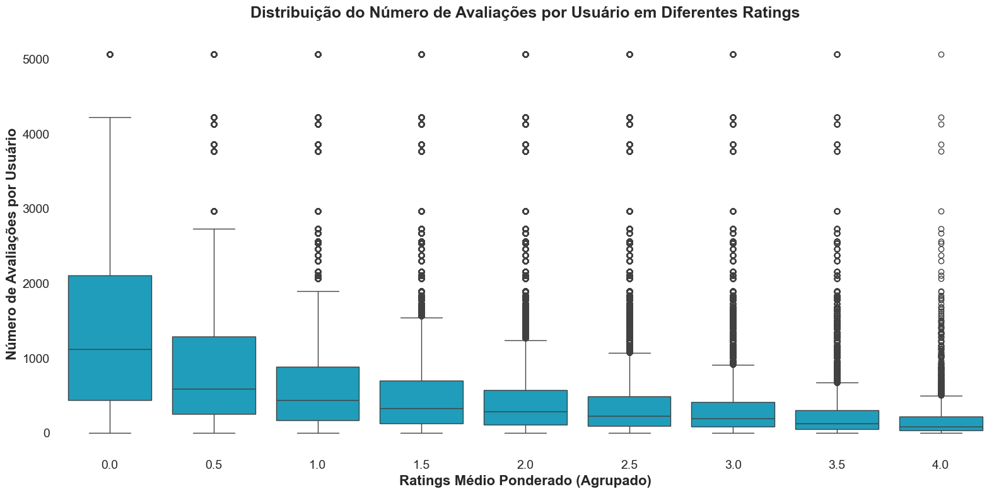

In [22]:
# Definir o estilo e a paleta de cores
sns.set(style="white", palette="pastel")

# Criar o gráfico de dispersão
plt.figure(figsize=(16, 8))
sns.boxplot(x=df['media_ponderada_arredondada'], y=df['Numero_de_Avaliacoes_por_usuarios'], color='#06ADD4')

# Configurações de rótulos e título
plt.ylabel('Número de Avaliações por Usuário', fontsize=16, weight='bold')
plt.xlabel('Ratings Médio Ponderado (Agrupado)', fontsize=16, weight='bold')
plt.title('Distribuição do Número de Avaliações por Usuário em Diferentes Ratings', fontsize=18, weight='bold', pad=20)

# Remover as linhas de grade superior e direita e outras bordas desnecessárias
sns.despine(left=True, bottom=True)

# Ajuste das ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Ajustar layout para evitar sobreposição
plt.tight_layout()

# Mostrar o gráfico
plt.show()


# **5. Quais filmes possuem mais avaliações?**

Observa-se que a maioria dos filmes com mais avaliações são do final da década de 90 e início dos anos 2000. O gênero, em sua maioria, é Ação, Comédia e Crime. 
<br>
Os filmes mais avaliados são, respectivamente: The Shawshank Redemption (1994) ; Forrest Gump (1994) e Pulp Fiction (1994).
<br>
Mas ao olhar a nuvem de palavras, vemos outros filmes se destacando: Star Wars, Harry Potter, Batman e Lord of Ring. O que eles tem em comum é que todos tem continuações. Então, se analisarmos as sagas como um todo, esses filmes também são muito avaliados. 

### Olhar as tabelas que serão utilizadas
Vamos utilizar algumas colunas das tabelas `movies_treino_transformado` e `ratings_treino_transformado`.

In [27]:
# Olhar as primeiras linhas da tabela que será ultilizada
movies_treino_transformado.head()

,movieId,title,genres,Ano_do_filme,titulo_sem_ano,genres_separado
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,Toy Story,Adventure
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995,Jumanji,Adventure
2,3,Grumpier Old Men (1995),Comedy|Romance,1995,Grumpier Old Men,Comedy
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,1995,Waiting to Exhale,Comedy
4,5,Father of the Bride Part II (1995),Comedy,1995,Father of the Bride Part II,Comedy


In [28]:
# Olhar as primeiras linhas da tabela que será ultilizada
ratings_treino_transformado.head()

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado
0,5,43,47,1567,5.0,4.057754,3.286254
1,461,1692,47,1567,4.5,4.057754,3.286254
2,751,469,47,1567,3.0,4.057754,3.286254
3,974,1160,47,1567,5.0,4.057754,3.286254
4,1174,12,47,1567,5.0,4.057754,3.286254


### Selecionar as colunas de interesse
A seguir, selecionaremos as colunas de interesse, para em seguida fazer a união das tabelas.

In [35]:
# Criar uma subtabela de 'movies_genero_separado
tmp_movie = movies_treino_transformado[['movieId', 'title' , 'titulo_sem_ano', 'genres_separado']]
tmp_movie.head(3)

,movieId,title,titulo_sem_ano,genres_separado
0,1,Toy Story (1995),Toy Story,Adventure
1,2,Jumanji (1995),Jumanji,Adventure
2,3,Grumpier Old Men (1995),Grumpier Old Men,Comedy


In [36]:
# Criar uma subtabela de 'ratings_data_hora3'
tmp_ratings = ratings_treino_transformado[['movieId','Numero_de_Avaliacoes_por_Filme']]
tmp_ratings.head(3)

,movieId,Numero_de_Avaliacoes_por_Filme
0,47,1567
1,47,1567
2,47,1567


### Unir as tabelas
Após selecionar as colunas de interesse, vamos unir estas tabelas. Em seguida, removeremos as linhas duplicadas e organizaremos as tabelas de forma decrescente.  

In [37]:
# Unir as subtabelas
filmes_mais_avaliados1 = pd.merge(tmp_movie , tmp_ratings, on='movieId' , how='right' )
filmes_mais_avaliados1.head(3) 

,movieId,title,titulo_sem_ano,genres_separado,Numero_de_Avaliacoes_por_Filme
0,47,Seven (a.k.a. Se7en) (1995),Seven (a.k.a. Se7en),Mystery,1567
1,47,Seven (a.k.a. Se7en) (1995),Seven (a.k.a. Se7en),Mystery,1567
2,47,Seven (a.k.a. Se7en) (1995),Seven (a.k.a. Se7en),Mystery,1567


In [38]:
# Remover as linhas duplicadas
filmes_mais_avaliados2 = filmes_mais_avaliados1.drop_duplicates(subset='title')

# Organizar de forma decrescente
filmes_mais_avaliados3 = filmes_mais_avaliados2.sort_values(by='Numero_de_Avaliacoes_por_Filme', ascending=False)
filmes_mais_avaliados3

,movieId,title,titulo_sem_ano,genres_separado,Numero_de_Avaliacoes_por_Filme
1811,318,"Shawshank Redemption, The (1994)","Shawshank Redemption, The",Crime,2948
5454,356,Forrest Gump (1994),Forrest Gump,Comedy,2700
41951,296,Pulp Fiction (1994),Pulp Fiction,Comedy,2609
25480,2571,"Matrix, The (1999)","Matrix, The",Action,2578
11878,593,"Silence of the Lambs, The (1991)","Silence of the Lambs, The",Crime,2512
...,...,...,...,...,...
811300,27480,Dead or Alive 2: Tôbôsha (2000),Dead or Alive 2: Tôbôsha,Action,1
811301,27549,Dead or Alive: Final (2002),Dead or Alive: Final,Comedy,1
787658,6588,And Now... Ladies and Gentlemen... (2002),And Now... Ladies and Gentlemen...,Romance,1
811316,31932,Fallen Angel (1945),Fallen Angel,Crime,1


### Tabela com os 100 filmes que possuem mais avaliações
Agora, nós temos a tabela final com os filmes que possuem mais avaliações.

In [68]:
# Selecionar as 30 primeiras linhas
filmes_mais_avaliados4 = filmes_mais_avaliados3.head(100) 
filmes_mais_avaliados4

,movieId,title,titulo_sem_ano,genres_separado,Numero_de_Avaliacoes_por_Filme
1811,318,"Shawshank Redemption, The (1994)","Shawshank Redemption, The",Crime,2948
5454,356,Forrest Gump (1994),Forrest Gump,Comedy,2700
41951,296,Pulp Fiction (1994),Pulp Fiction,Comedy,2609
25480,2571,"Matrix, The (1999)","Matrix, The",Action,2578
11878,593,"Silence of the Lambs, The (1991)","Silence of the Lambs, The",Crime,2512
...,...,...,...,...,...
279879,34,Babe (1995),Babe,Children,936
64312,7438,Kill Bill: Vol. 2 (2004),Kill Bill: Vol. 2,Action,935
118762,68954,Up (2009),Up,Adventure,926
52676,1206,"Clockwork Orange, A (1971)","Clockwork Orange, A",Crime,918


### Gráfico com os 100 filmes que possuem mais avaliações

In [69]:
# Criar o gráfico de barras horizontais com Plotly
fig = px.bar(filmes_mais_avaliados4, 
             y='title', 
             x='Numero_de_Avaliacoes_por_Filme', 
             orientation='h',
             color_discrete_sequence=['#046D86'],
             title='Os 100 filmes que possuem mais avaliações',
             labels={'Numero_de_Avaliacoes_por_Filme': 'Número de Avaliações por Filme', 
                     'title': 'Título do Filme'})

# Ajustar layout para um visual mais minimalista
fig.update_layout(
    width=1000,
    height=1700,
    title=dict(
        text='Os 100 filmes com mais avaliações',
        x=0.5,  # Centralizar o título
        xanchor='center',
        font=dict(size=20, family='Arial', color='black', weight='bold')  # Negrito
    ),
    xaxis_title_font=dict(size=12, family='Arial', color='black'),
    yaxis_title_font=dict(size=14, family='Arial', color='black'),  # Aumentar tamanho da fonte
    font=dict(size=12),  # Aumentar tamanho da fonte geral
    plot_bgcolor='white',
    yaxis=dict(
        autorange='reversed',  # Inverter a ordem das barras
        tickfont=dict(size=14)  # Aumentar o tamanho dos valores do eixo y
    ),
    margin=dict(t=70, b=20, l=50, r=20)  # Ajustar as margens para mover o gráfico para cima
)

# Mostrar o gráfico
fig.show()


In [70]:
# Salvar o gráfico como um arquivo HTML
import plotly.io as pio
pio.write_html(fig, file='0s_100_filmes_com_mais_avaliacoes.html', auto_open=True)

<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.5/0s_100_filmes_com_mais_avaliacoes.html" width="140%" height="1800px" frameborder="0" scrolling="auto"></iframe>


## **Nuvem de palavras 1**
Além do gráfico de barras feito acima, vamos criar 2 nuvens de palavras para representar os filmes mais assitidos. <br>
A Nuvem de palavras 1 contém os 50 filmes mais avaliados.

### Preparar a base 1

In [81]:
# Olhar a tabela criada acima
#filmes_mais_avaliados3

In [79]:
# Selecionar os 50 primeiros valores únicos da coluna 'title'
top_50_titulos1 = filmes_mais_avaliados3['titulo_sem_ano'].unique()[:50]

# Filtrr o DataFrame para selecionar as linhas correspondentes aos 50 primeiros valores únicos de 'title'
top_50_titulos2 = filmes_mais_avaliados3[filmes_mais_avaliados3['titulo_sem_ano'].isin(top_50_titulos1) ] 
top_50_titulos2.head()

,movieId,title,titulo_sem_ano,genres_separado,Numero_de_Avaliacoes_por_Filme
3,318,"Shawshank Redemption, The (1994)","Shawshank Redemption, The",Crime,2948
6,356,Forrest Gump (1994),Forrest Gump,Comedy,2700
47,296,Pulp Fiction (1994),Pulp Fiction,Comedy,2609
31,2571,"Matrix, The (1999)","Matrix, The",Action,2578
10,593,"Silence of the Lambs, The (1991)","Silence of the Lambs, The",Crime,2512


In [52]:
# Concatena todos os títulos em uma única string
todos_titulos = ' '.join(top_50_titulos2['titulo_sem_ano'])

In [53]:
print("Quantidade de palavras:", len(todos_titulos))

Quantidade de palavras: 1130


### Nuvem 1

In [54]:
# Lista de Stopword
stop_words = set(STOPWORDS)

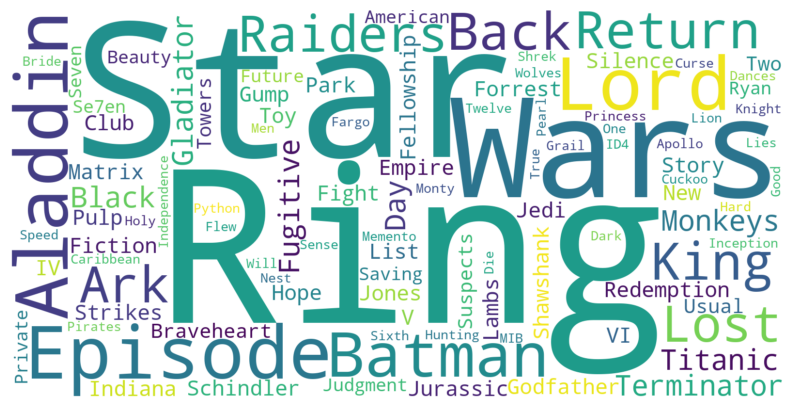

In [55]:
# Gerar a WordCloud
wordcloud_titulo1 = WordCloud(stopwords = stop_words,
                             background_color = 'white' , 
                             width = 1600 , height = 800).generate(todos_titulos)

# Plota a WordCloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud_titulo1, interpolation='bilinear')
plt.axis('off')
plt.show()                             

In [123]:
# Salvar wordcloud 
#wordcloud_titulo.to_file("wordcloud_titulo1.png")

## **Nuvem de palavras 2**
A Nuvem de palavras 2 contém os 300 filmes mais bem avaliados.Vamos utilizar uma máscara para que a nuvem fique com o formato de uma claquete de cinema.

Primeiro, vamos preparar a base selecionando os filmes e concatenando-os em uma úniva string.

In [56]:
# Selecionar os 300 primeiros valores únicos da coluna 'title'
top_300_titulos1 = filmes_mais_avaliados3['titulo_sem_ano'].unique()[:300]

# Filtra o DataFrame para selecionar as linhas correspondentes aos 300 primeiros valores únicos de 'title'
top_300_titulos2 = filmes_mais_avaliados3[filmes_mais_avaliados3['titulo_sem_ano'].isin(top_300_titulos1) ] 
top_300_titulos2.head()

,movieId,title,titulo_sem_ano,Numero_de_Avaliacoes_por_Filme
3,318,"Shawshank Redemption, The (1994)","Shawshank Redemption, The",2948
6,356,Forrest Gump (1994),Forrest Gump,2700
47,296,Pulp Fiction (1994),Pulp Fiction,2609
31,2571,"Matrix, The (1999)","Matrix, The",2578
10,593,"Silence of the Lambs, The (1991)","Silence of the Lambs, The",2512


In [73]:
# Concatena todos os títulos em uma única string
todos_titulos1 = ' '.join(top_300_titulos2['titulo_sem_ano'])

In [58]:
print(f"Quantidade de palavras: {len(todos_titulos1)} , quantidade de palavras únicas:{len(set(todos_titulos1))}")

Quantidade de palavras: 6106 , quantidade de palavras únicas:74


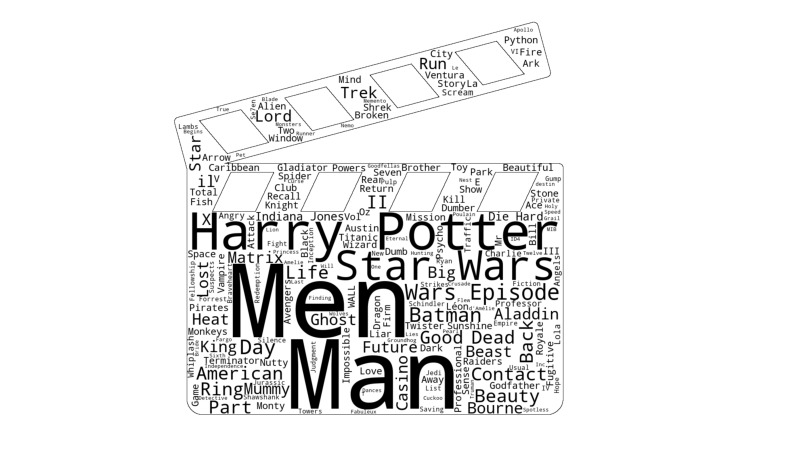

In [74]:
mascara_1 = np.array(Image.open("C:/0.Projetos/5.Sistema_de_Recomendação_MovieLens_2/Imagens/Análise_Descritiva/Mascaras/mascara_1.png" ))

# Lista de Stopword
stop_words = set(STOPWORDS)
    
# Gerar a word_cloud
wordcloud_titulo4b = WordCloud(stopwords = stop_words,
                             background_color = 'white', 
                             mask = mascara_1,
                             width = 1000 , height = 1000,
                             contour_color='black',
                             contour_width=1,
                             min_font_size= 6,
                             color_func=lambda *args, **kwargs: "black").generate(todos_titulos1)

# Plotar a WordCloud
plt.figure(figsize=(10, 10))
plt.imshow(wordcloud_titulo4b)
plt.axis('off')
plt.show()

In [131]:
# Salvar wordcloud 
wordcloud_titulo.to_file("wordcloud_titulo1b.png")

# **6.Quais filmes possuem as maiores notas?**
Ao analisar a nota, observamos um resultado semelhante ao tópico anterior.Os filmes mais bem avaliados são: The Shawshank Redemption (1994), Pulp Fiction (1994), Matrix (1999) e The Godfather (1972).<br>
Observa-se que a maioria dos filmes com as maiores notas são da década de 70 ao final da década 90. Ou seja, são filmes mais antigos do que se comparado ao tópico anterior. 	
<br>
E, os gêneros que se destacam são comédia, drama e crime.

### Preparar a base

In [72]:
# Selecionar as colunas de interesse
tmp_rating = ratings_treino_transformado[['movieId', 'rating_medio_ponderado']]
tmp_movies = movies_treino_transformado[['movieId', 'title', 'titulo_sem_ano', 'genres_separado']]

In [73]:
# Unir as tabelas
tmp_merge = pd.merge( tmp_movies, tmp_rating, on='movieId', how='inner')
tmp_merge.head(3)

,movieId,title,titulo_sem_ano,genres_separado,rating_medio_ponderado
0,1,Toy Story (1995),Toy Story,Adventure,3.264437
1,1,Toy Story (1995),Toy Story,Adventure,3.264437
2,1,Toy Story (1995),Toy Story,Adventure,3.264437


In [84]:
# Remover as linhas duplicadas de "title"
top_rating = tmp_merge.drop_duplicates( subset=['title'])

# Organizar de forma decrescente
top_rating1 = top_rating.sort_values(by='rating_medio_ponderado', ascending=False)

# Selecionar os Top 30
top_rating2 = top_rating1.head(100)

### Tabela com os 100 filmes com os maiores rating médio (ponderado)

In [75]:
# Os 30 filmes com as maiores notas
top_rating2

,movieId,title,titulo_sem_ano,genres_separado,rating_medio_ponderado
64993,318,"Shawshank Redemption, The (1994)","Shawshank Redemption, The",Crime,3.888469
58904,296,Pulp Fiction (1994),Pulp Fiction,Comedy,3.650467
351123,2571,"Matrix, The (1999)","Matrix, The",Action,3.630555
150000,858,"Godfather, The (1972)","Godfather, The",Crime,3.621123
105900,527,Schindler's List (1993),Schindler's List,Drama,3.583505
122380,593,"Silence of the Lambs, The (1991)","Silence of the Lambs, The",Crime,3.578315
75357,356,Forrest Gump (1994),Forrest Gump,Comedy,3.565995
387793,2959,Fight Club (1999),Fight Club,Action,3.549180
18128,50,"Usual Suspects, The (1995)","Usual Suspects, The",Crime,3.537581
51068,260,Star Wars: Episode IV - A New Hope (1977),Star Wars: Episode IV - A New Hope,Action,3.533020


In [45]:
del tmp_merge, tmp_movies, tmp_rating

### Gráfico com os Filmes com as maiores rating médio (ponderado)

In [94]:

# Criar o gráfico de barras horizontais com Plotly
fig = px.bar(top_rating2, 
             y='title', 
             x='rating_medio_ponderado', 
             orientation='h',
             color_discrete_sequence=['#046D86'],
             title='Os 100 filmes com as maiores notas',
             labels={'Numero_de_Avaliacoes_por_Filme': 'Número de Avaliações por Filme', 
                     'title': 'Título do Filme'})

# Ajustar layout para um visual mais minimalista
fig.update_layout(
    width=1000,
    height=1700,
    title=dict(
        text='Os 100 filmes com as maiores notas',
        x=0.5,  # Centralizar o título
        xanchor='center',
        font=dict(size=20, family='Arial', color='black', weight='bold')  # Negrito
    ),
    xaxis_title_font=dict(size=12, family='Arial', color='black'),
    yaxis_title_font=dict(size=14, family='Arial', color='black'),  # Aumentar tamanho da fonte
    font=dict(size=12),  # Aumentar tamanho da fonte geral
    plot_bgcolor='white',
    yaxis=dict(
        autorange='reversed',  # Inverter a ordem das barras
        tickfont=dict(size=14)  # Aumentar o tamanho dos valores do eixo y
    ),
    margin=dict(t=70, b=20, l=50, r=20)  # Ajustar as margens para mover o gráfico para cima
)

# Mostrar o gráfico
fig.show()

In [95]:
pio.write_html(fig, file='Os_100_filmes_com_as_maiores_notas.html', auto_open=True)

<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.6/Os_100_filmes_com_as_maiores_notas.html" width="140%" height="1800px" frameborder="0" scrolling="auto"></iframe>

## Nuvem de Palavras - Rating Medio Ponderado

### Nuvem 1 - Rating Médio Ponderado

In [134]:
# Selecionar os 50 primeiros valores únicos da coluna 'title'
top_titulos_rating = top_rating1['titulo_sem_ano'].unique()[:50]

# Filtra o DataFrame para selecionar as linhas correspondentes aos 50 primeiros valores únicos de 'title'
top_titulos_rating1 = top_rating1[top_rating1['titulo_sem_ano'].isin(top_titulos_rating) ] 

# Concatena todos os títulos em uma única string
todos_titulos_rating = ' '.join(top_titulos_rating1['titulo_sem_ano'])

print(f"Quantidade de palavras: {len(todos_titulos_rating)} , quantidade de palavras únicas:{len(set(todos_titulos_rating))}")

Quantidade de palavras: 1214 , quantidade de palavras únicas:59


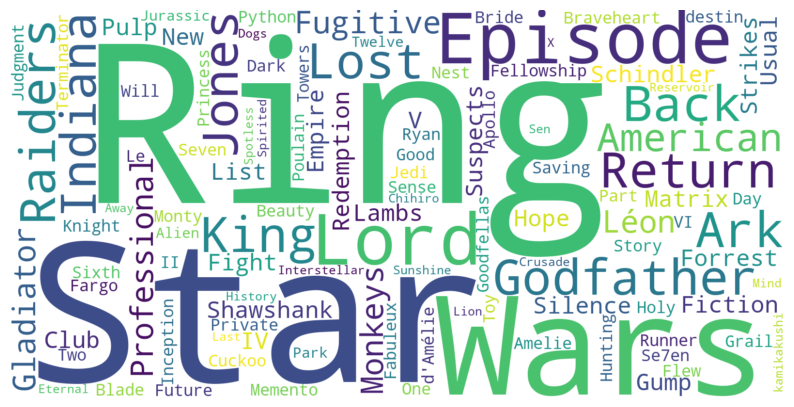

In [135]:
# Lista de Stopword
stop_words = set(STOPWORDS)

# Gerar a WordCloud
wordcloud_titulo_rating2 = WordCloud(stopwords = stop_words,
                             background_color = 'white' , 
                             width = 1600 , height = 800).generate(todos_titulos_rating)

# Plota a WordCloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud_titulo_rating2, interpolation='bilinear')
plt.axis('off')
plt.show()    

### Nuvem 2 - rating médio ponderado

In [ ]:
# Selecionar os 300 primeiros valores únicos da coluna 'title'
top_titulos_rating = top_rating1['titulo_sem_ano'].unique()[:300]

# Filtra o DataFrame para selecionar as linhas correspondentes aos 300 primeiros valores únicos de 'title'
top_titulos_rating1 = top_rating1[top_rating1['titulo_sem_ano'].isin(top_titulos_rating) ] 

# Concatena todos os títulos em uma única string
todos_titulos_rating = ' '.join(top_titulos_rating1['titulo_sem_ano'])

print(f"Quantidade de palavras: {len(todos_titulos_rating)} , quantidade de palavras únicas:{len(set(todos_titulos_rating))}")

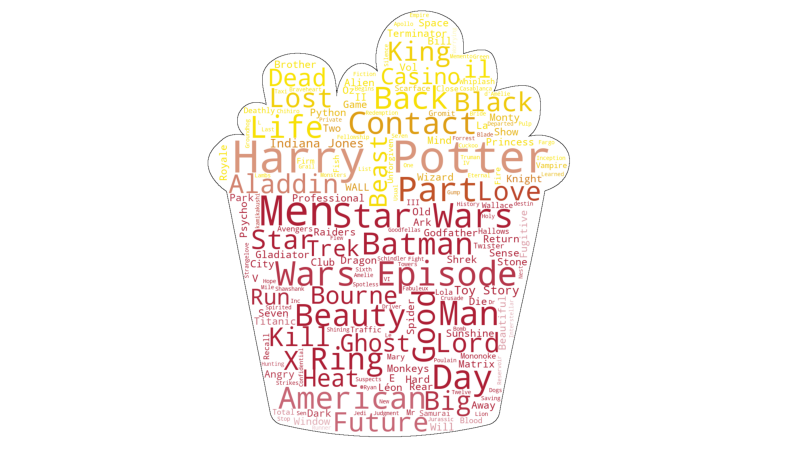

In [132]:
mascara_7 = np.array(Image.open("C:/0.Projetos/5.Sistema_de_Recomendação_MovieLens_2/Imagens/Análise_Descritiva/Mascaras/mascara_7.png" ))

# Lista de Stopword
stop_words = set(STOPWORDS)
    
# Gerar a word_cloud
wordcloud_titulo_rating2 = WordCloud(stopwords = stop_words,
                             background_color = 'white', 
                             mask = mascara_1,
                             contour_color='black',
                             contour_width=1,
                             width = 1000 ,
                             height = 1000).generate(todos_titulos_rating)

imagem_colorida_rating = ImageColorGenerator(mascara_7)
wordcloud_titulo_rating2.recolor(color_func=imagem_colorida_rating)                             

# Plotar a WordCloud
plt.figure(figsize=(10, 10))
plt.imshow(wordcloud_titulo_rating2)
plt.axis('off')
plt.show()

# **7. Quais gêneros possuem mais avaliações? Quais gêneros possuem as maiores notas?**
Os gêneros que possuem os maiores rating médio ponderado são respectivamente: Crime, Aventura e Mistério, Sci-Fi e Horror.
<br>
Já os gêneros que possuem os maiores números de avaliações são respectivamente: Crime, Aventura, Mistério, Ação e Sci-Fi.
Observa-se que os dois resultados são muito semelhantes
<br><br>
Estes resultados também foram encontrados por [Lu e Waterman (2005)](https://www.semanticscholar.org/paper/Changing-Markets%2C-New-Technology%2C-and-Violent-An-of-Lu-Waterman/6ccc1dd4d6c1c82f151ef299a94c56401f3f0d06). Os pesquisadores descobriram que os gêneros cinematográficos "propensos à violência" (como "ação", "aventura", "ficção científica" e "terror") aumentaram consideravelmente sua prevalência entre os 20 filmes de maior bilheteria dos EUA no período de 1967 a 2004. <br><br>
**Uma possível explicação encontrada pelos pesquisadores é que estes gêneros aumentaram o uso de tecnologia nos filmes.** <br><br>
<b><mark>Vale ressaltar que o estudo foca nos filmes de maior bilheteria, cujo público alvo são os jovens, conforme será explicado nos próximos tópicos.</mark></b>  
<br>
Apesar do resultado não ser abrangente, ele ajuda a explicar o porquê destes gêneros terem as maiores notas e mais avaliações.


### Preparar a tabela

In [16]:
# Selecionar as colunas de interesse
tmp_movie = movies_treino_transformado[['movieId', 'genres_separado' ]]
tmp_ratings = ratings_treino_transformado[['movieId','Numero_de_Avaliacoes_por_Filme', 'rating_medio_ponderado']]

# Unir as tabelas 
generos_ratings1 = pd.merge(tmp_movie , tmp_ratings, on='movieId' , how='right' )
generos_ratings1.head(3)


,movieId,genres_separado,Numero_de_Avaliacoes_por_Filme,rating_medio_ponderado
0,47,Mystery,1567,3.286254
1,175,Drama,140,1.258266
2,257,Mystery,104,1.032082


In [17]:
generos_ratings2 = generos_ratings1.drop_duplicates(subset=['genres_separado']).sort_values(by=['rating_medio_ponderado'], ascending= False)

In [18]:
#del tmp_movie,tmp_ratings,generos_ratings1

### Tabela com gêneros dos filmes, nº de avaliações e rating médio ponderado

In [18]:
generos_ratings2

,movieId,genres_separado,Numero_de_Avaliacoes_por_Filme,rating_medio_ponderado
3,318,Crime,2948,3.888469
114,4993,Adventure,1915,3.446509
0,47,Mystery,1567,3.286254
132,109487,Sci-Fi,1002,3.084144
64,1258,Horror,981,2.992502
7,380,Action,1243,2.693046
297,1199,Fantasy,457,2.439924
278,913,Film-Noir,382,2.318216
269,745,Animation,364,2.270124
770,128360,Western,286,1.914850


### Gráficos gêneros dos filmes, nº de avaliações e rating médio ponderado

In [ ]:
import plotly.graph_objs as go
import plotly.subplots as sp

# Criar uma figura e uma grade de subplots com 1 linha e 2 colunas
fig = sp.make_subplots(
    rows=1, cols=2, 
    subplot_titles=(
        'Gêneros com maior rating médio ponderado',
        'Gêneros com maior número de avaliações'
    ),
    horizontal_spacing=0.2,  # Aumentar o espaçamento horizontal entre os subplots
    vertical_spacing=0.02  # Espaçamento vertical entre os subplots
)

# Primeiro gráfico: rating médio ponderado
fig.add_trace(go.Bar(
    x=generos_ratings2['rating_medio_ponderado'],
    y=generos_ratings2['genres_separado'],
    orientation='h',
    text=[f'{x:.2f}' for x in generos_ratings2['rating_medio_ponderado']],
    textposition='outside',
    marker=dict(color='#03647A')
), row=1, col=1)

# Segundo gráfico: número de avaliações por filme
fig.add_trace(go.Bar(
    x=generos_ratings2['Numero_de_Avaliacoes_por_Filme'],
    y=generos_ratings2['genres_separado'],
    orientation='h',
    text=[f'{x:.0f}' for x in generos_ratings2['Numero_de_Avaliacoes_por_Filme']],
    textposition='outside',
    marker=dict(color='#03647A')
), row=1, col=2)

# Atualizar layout dos gráficos
fig.update_layout(
    height=450,  # Ajustar a altura da figura
    width=900,
    showlegend=False,
    plot_bgcolor='white',
    margin=dict(t=50, b=50, l=50, r=50),  # Ajustar as margens
)

# Atualizar layout do primeiro subplot
fig.update_xaxes(title_text='Rating Médio (Ponderado)', row=1, col=1)
fig.update_yaxes(title_text='Gêneros de Filme', row=1, col=1, tickfont=dict(size=12, family='Arial, bold', weight='bold'))
fig.update_yaxes(autorange="reversed", row=1, col=1)  # Inverter a ordem dos gêneros

# Atualizar layout do segundo subplot
fig.update_xaxes(title_text='Número de Avaliações por Filme', row=1, col=2)
fig.update_yaxes(title_text='Gêneros de Filme', row=1, col=2, tickfont=dict(size=12, family='Arial, bold',weight='bold'))
fig.update_yaxes(autorange="reversed", row=1, col=2)  # Inverter a ordem dos gêneros

# Exibir o gráfico
fig.show()


In [63]:
# Salvar o gráfico como um arquivo HTML
import plotly.io as pio
pio.write_html(fig, file='Ranking_Generos_de_Filme.html', auto_open=True)


<!-- Aqui você pode colar o conteúdo do arquivo grafico_rating_contagem.html -->
<!-- Por exemplo, o conteúdo abaixo é um exemplo reduzido -->
<!--<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.7/Ranking_Generos_de_Filme.html" width="950" height="500"></iframe>-->
<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.7/Ranking_Generos_de_Filme.html" width="150%" height="500px" frameborder="0" scrolling="auto"></iframe>

# **8. De quais anos são os filmes mais assistidos? E os mais bem avaliados?**
Os filmes mais assistidos são dos anos de 1995, 1994, 1999, 1996 e 2000, respectivamente. 
Até 1992, a quantidade de avalições por ano cresce timidamente. Entre 1993 e 2000, ela cresce de forma significativa. E, a partir dos anos 2001, a quantidade de avaliações começa a diminuir. 
<br><br>
Os filmes mais bem avaliados são os de 1977, 1972, 1975, 1994 e 1980, respectivamente. Ao olhar o gráfico, vemos que as avalições médias por ano aumentam por volta de 1920 e continuam crescendo, com algumas oscilações até 2001. 
<br><br>
Os filmes mais bem avaliados são mais antigos, possivelmente, são os filmes considerados clássicos. Já os filmes mais assistidos são um pouco mais novos, entre os anos 90 e início dos anos 2000.Esta foi a época que a internet se popularizou, o que facilitou a divulgação midiática dos filmes. 
<br><br>
Em ambos os gráficos, o número de avalições por ano e a contagem de filmes assistidos diminui a partir dos anos 2000. <br>
De acordo com o site [Britannica (history of film)](https://www.britannica.com/art/history-of-the-motion-picture/Transition-to-the-21st-century#ref284140),no final do século XX houve um aumento da capacidade de animação por computador e de câmeras de vídeo digitais,  isso fez com que **muitos cineastas utilizassem tais tecnologias para reduzir os custos de produção.**<br><br>
Além disso, nesta mesma época surgiu os DVDs, houve uma ampliação do acesso a TV a cabo e aos cinemas. Esses fatores contribuíram na internacionalização mercado cinematográfico. E com isso, os EUA ampliou seu domínio no cinema mundial. **No final da década de 90,  a produção de filmes nos EUA focou nos espectadores adolescentes, e de acordo com os críticos, isso diminuiu a qualidade dos filmes.**  
<br><br>
<b><mark>Portanto, existem dois fatores que podem explicar a queda nos gráficos a partir dos anos 2000: Aumento do uso de tecnologia gráfica nos filmes e foco no público jovem.</mark></b>
<br><br>
 

### Preparando as tabelas

Primeiro, vamos olhar as tabela que serão unidas

In [55]:
movies_treino_transformado.head(3)


,movieId,title,genres,Ano_do_filme,titulo_sem_ano,genres_separado
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,1995,Toy Story,Adventure
1,2,Jumanji (1995),Adventure|Children|Fantasy,1995,Jumanji,Adventure
2,3,Grumpier Old Men (1995),Comedy|Romance,1995,Grumpier Old Men,Comedy


In [56]:
ratings_treino_transformado.head(3)

,userId,Numero_de_Avaliacoes_por_usuarios,movieId,Numero_de_Avaliacoes_por_Filme,rating,rating_medio_simples,rating_medio_ponderado
0,5,43,47,1567,5.0,4.057754,3.286254
1,5,43,175,140,4.0,3.482143,1.258266
2,5,43,257,104,4.0,3.341346,1.032082


Vamos unir as tabelas

In [57]:
# Unir as tabela e selecionar as colunas de interesse
ano_filme_rating = pd.merge(movies_treino_transformado[['movieId','title','Ano_do_filme']], 
                            ratings_treino_transformado[['movieId', 'rating_medio_ponderado']], 
                            on="movieId", how="inner")
ano_filme_rating.head()                             

,movieId,title,Ano_do_filme,rating_medio_ponderado
0,1,Toy Story (1995),1995,3.264437
1,1,Toy Story (1995),1995,3.264437
2,1,Toy Story (1995),1995,3.264437
3,1,Toy Story (1995),1995,3.264437
4,1,Toy Story (1995),1995,3.264437


Agora, vamos remover as linhas cujo "Ano_do_filme" é igual a -1, pois são as observações em que não foi possível extrair o ano do filme.

In [58]:
# Remover linhas onde a coluna 'Ano_do_filme' tem valor -1
ano_filme_rating1 = ano_filme_rating.loc[ano_filme_rating['Ano_do_filme'] != -1]  

Faremos a contagem de avaliações por ano do filme.

In [59]:
# Fazer a contagem
contagem_movies = ano_filme_rating1[['Ano_do_filme']].value_counts(ascending=False).reset_index()
contagem_movies.head()

,Ano_do_filme,count
0,1995,45559
1,1994,39641
2,1999,35463
3,1996,33980
4,2000,30310


Será criada a coluna ratin_medio_por_ano

In [60]:
# Agrupar os dados pela coluna 'Ano_do_filme' e calcular a média da coluna 'rating_medio_ponderado'
rating_medio_por_ano1 = ano_filme_rating1.groupby('Ano_do_filme')['rating_medio_ponderado'].mean().reset_index()

# Renomear a coluna de média para 'rating_medio_por_ano'
rating_medio_por_ano1 = rating_medio_por_ano1.rename(columns={'rating_medio_ponderado': 'rating_medio_por_ano'})
rating_medio_por_ano1.head()

,Ano_do_filme,rating_medio_por_ano
0,1878,0.098156
1,1887,0.035130
2,1895,0.133113
3,1896,0.112191
4,1897,0.084134


**A seguir temos a tabela final**

In [61]:
# Unir as tabelas 
movies_ratings = pd.merge(rating_medio_por_ano1, contagem_movies, on="Ano_do_filme", how='inner' )
movies_ratings 

,Ano_do_filme,rating_medio_por_ano,count
0,1878,0.098156,1
1,1887,0.035130,2
2,1895,0.133113,8
3,1896,0.112191,8
4,1897,0.084134,3
...,...,...,...
123,2019,0.917894,5966
124,2020,0.448593,2484
125,2021,0.420438,2104
126,2022,0.421568,1477


#### Tabela com a contagem dos filmes mais assistidos
Vamos criar a tabela com os filmes mais assistidos.

In [62]:
movies_ratings_count = movies_ratings.sort_values(by='count',ascending=False)
movies_ratings_count1 = movies_ratings_count.head(5)
movies_ratings_count1.head()

,Ano_do_filme,rating_medio_por_ano,count
99,1995,2.075816,45559
98,1994,2.255304,39641
103,1999,2.071166,35463
100,1996,1.742998,33980
104,2000,1.819669,30310


#### Tabela dos filmes com as maiores avaliações

In [63]:
movies_ratings_top = movies_ratings.sort_values(by='rating_medio_por_ano',ascending=False)
movies_ratings_top1 = movies_ratings_top.head(5)
movies_ratings_top1.head()

,Ano_do_filme,rating_medio_por_ano,count
81,1977,2.413250,4823
76,1972,2.335413,3452
79,1975,2.311737,5111
98,1994,2.255304,39641
84,1980,2.200814,7491


### Gráfico

In [ ]:
# Ordenando por ano
movies_ratings = movies_ratings.sort_values('Ano_do_filme')

# Dados para o gráfico de rating médio por ano
line_rating = go.Scatter(
    x=movies_ratings['Ano_do_filme'],
    y=movies_ratings['rating_medio_por_ano'],
    mode='lines+markers',
    name='Rating Médio',
    line=dict(color='#006868', width=2),
    marker=dict(size=8, color='#006868'),
)

# Destacar os 5 maiores anos de rating médio
top_5_years_rating = movies_ratings.nlargest(5, 'rating_medio_por_ano')
highlighted_points_rating = go.Scatter(
    x=top_5_years_rating['Ano_do_filme'],
    y=top_5_years_rating['rating_medio_por_ano'],
    mode='markers',
    name='Top 5 Anos',
    marker=dict(size=12, color='gold', symbol='star', line=dict(color='black', width=2)),
    showlegend=False,
)

# Dados para o gráfico de contagem por ano
line_count = go.Scatter(
    x=movies_ratings['Ano_do_filme'],
    y=movies_ratings['count'],
    mode='lines+markers',
    name='Contagem',
    line=dict(color='#7D01D6', width=2),
    marker=dict(size=8, color='#7D01D6')
)

# Destacar os 5 maiores anos de contagem
top_5_years_count = movies_ratings.nlargest(5, 'count')
highlighted_points_count = go.Scatter(
    x=top_5_years_count['Ano_do_filme'],
    y=top_5_years_count['count'],
    mode='markers',
    name='Top 5 Anos',
    marker=dict(size=12, color='gold', symbol='star', line=dict(color='black', width=2)),
    showlegend=False,
)

# Criar figuras e subplots
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                    subplot_titles=('Ano dos Filmes com as maiores avaliações', 'Ano dos Filmes mais assitidos'))
fig.add_trace(line_rating, row=1, col=1)
fig.add_trace(highlighted_points_rating, row=1, col=1)
fig.add_trace(line_count, row=2, col=1)
fig.add_trace(highlighted_points_count, row=2, col=1)

# Atualizar layout do subplot de Rating Médio por Ano
fig.update_xaxes(#title_text='Ano do Filme', 
                 tickangle=360, 
                 tickmode='linear', tick0=movies_ratings['Ano_do_filme'].min(), 
                 dtick=5, range=[movies_ratings['Ano_do_filme'].min(), movies_ratings['Ano_do_filme'].max()], row=1, col=1,
                 showgrid=True,gridcolor='rgba(0,0,0,0.1)',)
fig.update_yaxes(title_text='Rating Médio por ano', row=1, col=1,showgrid=True,gridcolor='rgba(0,0,0,0.1)',)


# Atualizar layout do subplot de Contagem por Ano
fig.update_xaxes(title_text='Ano do Filme', tickangle=360, tickmode='linear',
                 tick0=movies_ratings['Ano_do_filme'].min(), dtick=5, range=[movies_ratings['Ano_do_filme'].min(), 
                 movies_ratings['Ano_do_filme'].max()], row=2, col=1,tickfont=dict(size=10),      
                 showgrid=True,gridcolor='rgba(0,0,0,0.1)',)
fig.update_yaxes(title_text='Contagem', row=2, col=1,showgrid=True,gridcolor='rgba(0,0,0,0.1)',)

# Atualizar layout da figura geral
fig.update_layout(
    #title='Ano dos Filmes com as maiores avaliações e mais assistidos',
    title_font=dict(family='Arial', size=24, color='black', weight='bold'),
    width=1100,  # Definindo a largura da figura para 1500 pixels
    plot_bgcolor='white',
    #hovermode='x',
    margin=dict(l=50, r=50, t=50, b=50),
)

# Exibir o gráfico
fig.show()


In [52]:
# Salvar o gráfico como um arquivo HTML
pio.write_html(fig, file='Ano_dos_Filmes_com_as_maiores_avaliacoes_e_mais_assistidos.html', auto_open=True)

<!-- Colar o Gráfico interativo em HTML -->
<!--<iframe src="C:/0.Projetos/5.Sistema_de_Recomendacao_MovieLens_2/Ano_dos_Filmes_com_as_maiores_avaliacoes_e_mais_assistidos.html" width="1100" height="600"></iframe>-->
<iframe src="https://catarinaaguiar3.github.io/Projeto_Sistema_de_Recomendacao_MovieLens/Imagens/Analise_Descritiva/Q.8/Ano_dos_Filmes_com_as_maiores_avaliacoes_e_mais_assistidos.html" width="150%" height="500px" frameborder="0" scrolling="auto"></iframe>

# **Insights**

## **1.	Os usuários podem estar insatisfeitos com as recomendações do site**
A nota média dada pelo usuário (rating) foi de 3,52 (tópico 2) e essa média diminui conforme o usuário faz mais avaliações (tópicos 3 e 4). Além disso, o número de avaliações por usuário é baixo , a maioria faz 15 avaliações (tópico 3). Estes resultados, podem ser reflexo de uma insatisfação com as recomendações. <br><br>
Seria interessante a MovieLens investigar o comportamento destes usuários para melhorar as recomendações e aumentar a retenção
Para isso, o site poderia:
<ul>
    <li><b>Analisar o número de avaliações vs média (rating) ao longo do tempo</b>: Isto seria interessante para entender se existe um padrão temporal no uso do site MovieLens. Exemplo: por quanto tempo um usuário utiliza ativamente o site?</li> 
    <li><b>Fazer segmentações:</b> o MovieLens poderia segmentar os usuários por idade e gênero para descobrir como as notas dadas variam em cada grupo e assim, pensar em recomendações personalizadas para cada segmento de usuário.</li>
</ul>
<br>
Espera-se que após estas análises, o MovieLens melhore a média de ratings e aumente o número de avaliações por usuário.

## **2. Gêneros de destaque**
Os gêneros de filme Crime, Aventura e Mistério possuem as maiores notas e os maiores números de avaliações (tópico 7). Para empresas como a Netflix, esta é uma informação relevante para decidir em quais gêneros ela deve investir na hora de produzir um filme.

## **3. Explorar diferentes de nichos**

#### **1. Nicho: Filmes dos anos 90 – 2000**
Os filmes mais avaliados são do final da década de 90 e início dos anos 2000, principalmente dos gêneros Ação, Comédia e Crime (tópico 5)

#### **2. Nicho: Filmes clássicos**
Os filmes com as maiores avaliações são das décadas de 70 a 90, nos gêneros comédia, drama e crime (tópico 6). Em toda a análise, o gênero drama se destacou apenas neste nicho. Assim, se empresas como a Netflix buscam adquirir direitos autorais de dramas, devem considerar filmes clássicos.

#### **3. Sagas**
Apesar das sagas não aparecem no ranking dos filmes mais avaliados e com as maiores notas, as nuvens de palavras dos tópicos 4 e 5 mostram que as sagas ganham destaque quando consideradas em conjunto. Portanto, filmes de sagas podem ser um nicho interessante para aquisição de direitos autorais por plataformas de streaming.

#### **4. Nicho Jovem**
Conforme explicado no tópico 7, filmes propensos a violência (Crime, Aventura e Mistério) e que usam mais tecnologia,  chamam atenção do público jovem. 

#### **5. Nicho pessoas mais velhas**
O tópico 8 revela que a partir dos anos 2000 a média de avaliações por ano caiu, possivelmente devido à mudança de foco para o público jovem e ao uso excessivo de computação gráfica nos filmes. Em contraste com o nicho 4, este poderia se concentrar em filmes com menos efeitos visuais e que atendam a um público mais maduro, como filmes independentes.
<br>

> **OBS:** O dataset não tem informações sobre os usuários, isso limitou um pouco uma análise mais profunda. Se estas informações estivessem disponíveis, seria interessante analisar a relação de cada nicho de filme com os diferentes perfis de clientes/usuários.
